<a href="https://colab.research.google.com/github/ridz3/Interpretability-and-XAI-of-LLMs/blob/main/XAI_interpreatability.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("debasisdotcom/parkinson-disease-detection")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/parkinson-disease-detection


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


import torch
from torch import optim
from torch import nn
from torch.utils.data import DataLoader
from tqdm import tqdm

# !pip install torchvision
import torchvision

import torch.nn.functional as F
import torchvision.datasets as datasets
import torchvision.transforms as transforms

!pip install torchmetrics
import torchmetrics

In [ ]:
import os
from torch.utils.data import Dataset, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report

In [ ]:
df = pd.read_csv('/kaggle/input/parkinson-disease-detection/Parkinsson disease.csv')
df.head()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


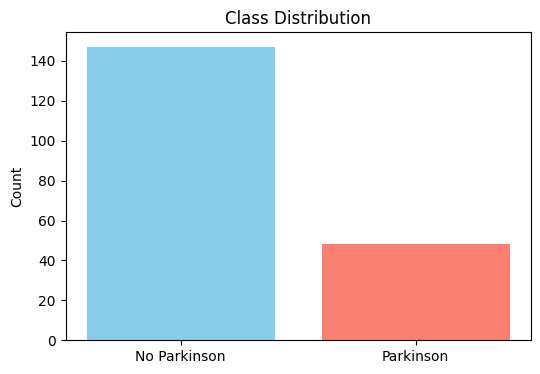

In [ ]:
# Check class distribution
labels = ['No Parkinson', 'Parkinson']
counts = df['status'].value_counts()
plt.figure(figsize=(6,4))
plt.bar(labels, counts, color=['skyblue', 'salmon'])
plt.title("Class Distribution")
plt.ylabel("Count")
plt.show()

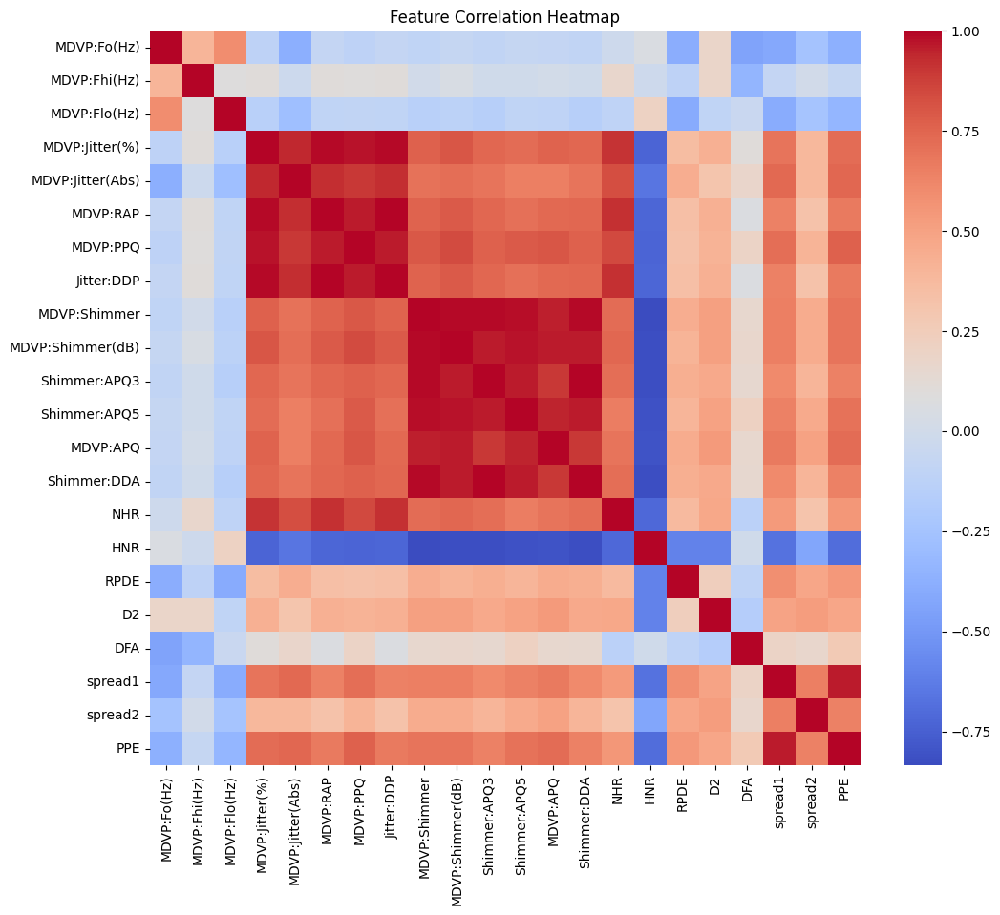

In [ ]:
# Correlation Heatmap
plt.figure(figsize=(12,10))
correlation = df[feature_cols].corr()
sns.heatmap(correlation, cmap='coolwarm', annot=False)
plt.title("Feature Correlation Heatmap")
plt.show()

<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)
<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)


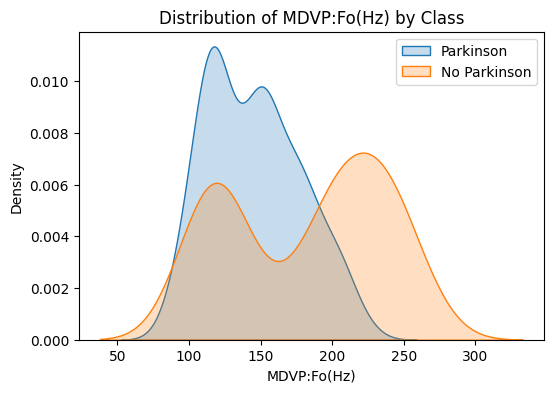

<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)
<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)


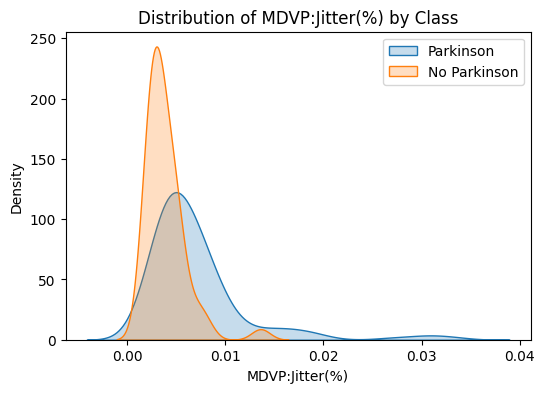

<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)
<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)


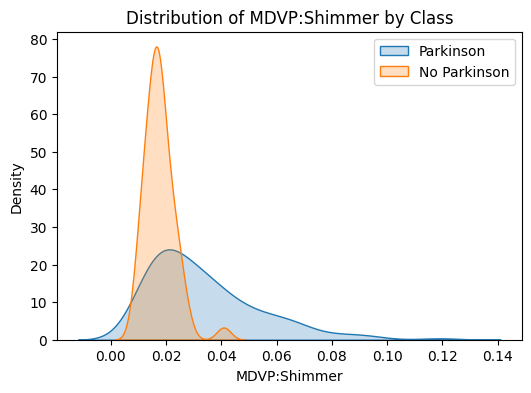

<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)
<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)


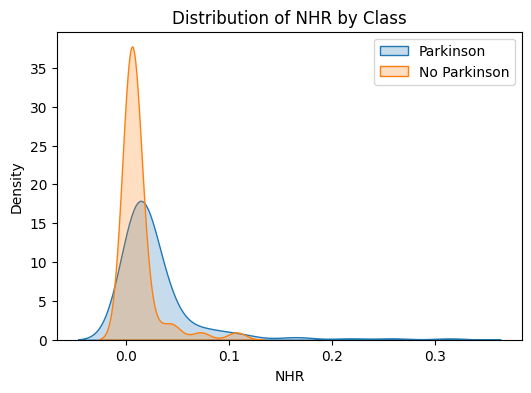

<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)
<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)


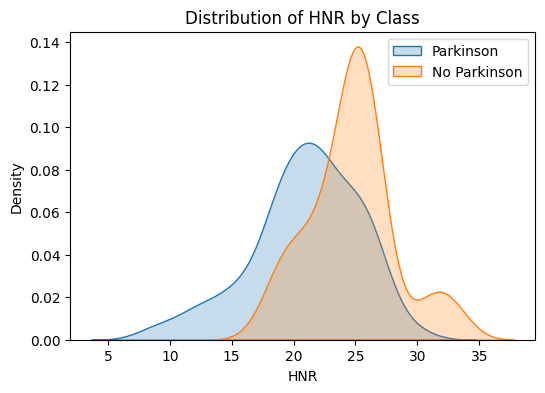

<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)
<ipython-input-23-7e62f1416ae5>:8: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)


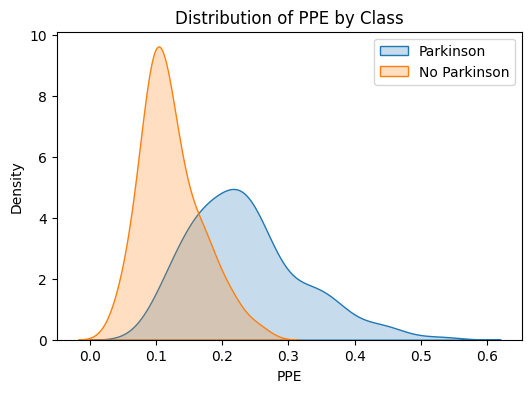

In [ ]:
# Example: Plot distribution of 6 important features
important_features = ['MDVP:Fo(Hz)', 'MDVP:Jitter(%)', 'MDVP:Shimmer', 'NHR', 'HNR', 'PPE']

for feat in important_features:
    plt.figure(figsize=(6, 4))
    for label in df['status'].unique():
        subset = df[df['status'] == label]
        sns.kdeplot(subset[feat], label=f"{'Parkinson' if label==1 else 'No Parkinson'}", shade=True)
    plt.title(f"Distribution of {feat} by Class")
    plt.legend()
    plt.show()

In [ ]:
# Define feature columns based on the description
feature_cols = [
    'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
    'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
    'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
    'MDVP:APQ', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'D2', 'DFA',
    'spread1', 'spread2', 'PPE'
]
target_col = 'status'

In [ ]:
X = df[feature_cols].values
y = df[target_col].values

In [ ]:
# Feature Scaling
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Reshape for 1D CNN (batch_size, num_channels, sequence_length)
X_reshaped = X_scaled.reshape(X_scaled.shape[0], 1, X_scaled.shape[1])

In [ ]:
# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y, test_size=0.2, random_state=42)

In [ ]:
# Convert to PyTorch Tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32).unsqueeze(1)

In [ ]:
# Create DataLoaders
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=28, shuffle=True)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size=28)

In [ ]:
# 2. Define the 1D CNN Model with 4 Convolutional Layers
class Parkinson1DCNN_4Layers(nn.Module):
    def __init__(self, num_features):
        super(Parkinson1DCNN_4Layers, self).__init__()
        self.conv1 = nn.Conv1d(in_channels=1, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm1d(16)
        self.relu1 = nn.ReLU()
        self.pool1 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout1 = nn.Dropout(0.2)

        self.conv2 = nn.Conv1d(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm1d(32)
        self.relu2 = nn.ReLU()
        self.pool2 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout2 = nn.Dropout(0.3)

        self.conv3 = nn.Conv1d(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.bn3 = nn.BatchNorm1d(64)
        self.relu3 = nn.ReLU()
        self.pool3 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout3 = nn.Dropout(0.3)

        self.conv4 = nn.Conv1d(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1)
        self.bn4 = nn.BatchNorm1d(128)
        self.relu4 = nn.ReLU()
        self.pool4 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout4 = nn.Dropout(0.3)

        # Calculate the size of the flattened layer
        # Original input size: num_features
        # After pool1: num_features / 2
        # After pool2: num_features / 4
        # After pool3: num_features / 8
        # After pool4: num_features / 16
        flattened_size = 128 * (num_features // 16)
        self.fc1 = nn.Linear(flattened_size, 128)
        self.bn5 = nn.BatchNorm1d(128)
        self.relu5 = nn.ReLU()
        self.dropout5 = nn.Dropout(0.5)
        self.fc2 = nn.Linear(128, 1)
        self.sigmoid = nn.Sigmoid()

        self.flatten = nn.Flatten()

    def forward(self, x):
        x = self.dropout1(self.pool1(self.relu1(self.bn1(self.conv1(x)))))
        x = self.dropout2(self.pool2(self.relu2(self.bn2(self.conv2(x)))))
        x = self.dropout3(self.pool3(self.relu3(self.bn3(self.conv3(x)))))
        x = self.dropout4(self.pool4(self.relu4(self.bn4(self.conv4(x)))))
        x = self.flatten(x)
        x = self.dropout5(self.relu5(self.bn5(self.fc1(x))))
        x = self.sigmoid(self.fc2(x))
        return x

In [ ]:
# Instantiate the model with 4 convolutional layers
num_features = X_scaled.shape[1]
model = Parkinson1DCNN_4Layers(num_features)

In [ ]:
# 3. Define Loss Function and Optimizer
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

In [ ]:
# 4. Train the Model
epochs = 100 # Increased epochs to allow the deeper network to learn
for epoch in range(epochs):
    model.train()
    total_loss = 0
    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item() * inputs.size(0)
    avg_loss = total_loss / len(train_loader.dataset)
    print(f'Epoch [{epoch+1}/{epochs}], Training Loss: {avg_loss:.4f}')

Epoch [1/100], Training Loss: 0.6907
Epoch [2/100], Training Loss: 0.6037
Epoch [3/100], Training Loss: 0.5465
Epoch [4/100], Training Loss: 0.4864
Epoch [5/100], Training Loss: 0.4696
Epoch [6/100], Training Loss: 0.4444
Epoch [7/100], Training Loss: 0.4580
Epoch [8/100], Training Loss: 0.3964
Epoch [9/100], Training Loss: 0.3927
Epoch [10/100], Training Loss: 0.4213
Epoch [11/100], Training Loss: 0.3918
Epoch [12/100], Training Loss: 0.3825
Epoch [13/100], Training Loss: 0.4066
Epoch [14/100], Training Loss: 0.3933
Epoch [15/100], Training Loss: 0.3833
Epoch [16/100], Training Loss: 0.3779
Epoch [17/100], Training Loss: 0.3553
Epoch [18/100], Training Loss: 0.3577
Epoch [19/100], Training Loss: 0.3344
Epoch [20/100], Training Loss: 0.3054
Epoch [21/100], Training Loss: 0.3203
Epoch [22/100], Training Loss: 0.3651
Epoch [23/100], Training Loss: 0.3374
Epoch [24/100], Training Loss: 0.3451
Epoch [25/100], Training Loss: 0.3254
Epoch [26/100], Training Loss: 0.3176
Epoch [27/100], Train

In [ ]:
# 5. Evaluate the Model
model.eval()
all_predictions = []
all_labels = []
with torch.no_grad():
    for inputs, labels in test_loader:
        outputs = model(inputs)
        predicted = (outputs > 0.5).float()
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

In [ ]:
accuracy = accuracy_score(all_labels, all_predictions)
report = classification_report(all_labels, all_predictions)
print(f'Accuracy on Test Set: {accuracy:.4f}')
print('Classification Report:\n', report)

Accuracy on Test Set: 0.9231
Classification Report:
               precision    recall  f1-score   support

         0.0       1.00      0.57      0.73         7
         1.0       0.91      1.00      0.96        32

    accuracy                           0.92        39
   macro avg       0.96      0.79      0.84        39
weighted avg       0.93      0.92      0.91        39



In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 9.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=3c9e45095ca439800a0bc9e07452c771e675112302f389099e673d328015d1f9
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


In [ ]:
def predict_proba_lime(input_array):
    model.eval()
    with torch.no_grad():
        input_tensor = torch.tensor(input_array, dtype=torch.float32).unsqueeze(1)  # shape: [N, 1, 22]
        output = model(input_tensor).cpu().numpy()  # shape: [N, 1]
        probs = np.concatenate([1 - output, output], axis=1)  # shape: [N, 2]
    return probs

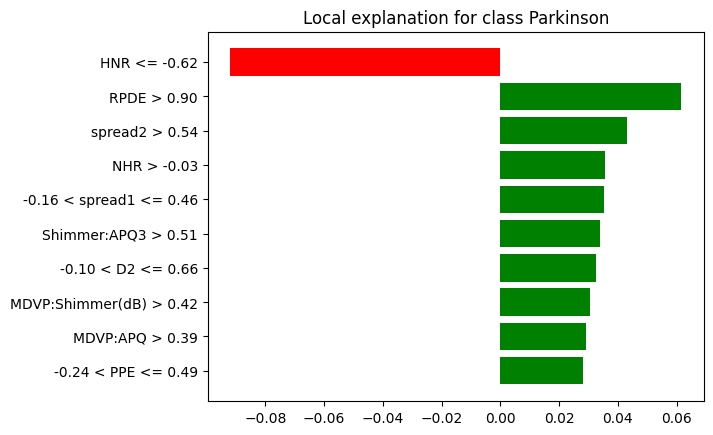

In [ ]:
from lime import lime_tabular

# Create LIME explainer
explainer = lime_tabular.LimeTabularExplainer(
    training_data=X_train.reshape(X_train.shape[0], -1),  # Flatten to 2D
    feature_names=feature_cols,
    class_names=['No Parkinson', 'Parkinson'],
    mode='classification'
)

# Pick a sample from the test set (e.g., the first one)
i = 0
sample = X_test[i].reshape(1, -1)

# Explain prediction
explanation = explainer.explain_instance(
    data_row=sample[0],
    predict_fn=predict_proba_lime,
    num_features=10
)

# Show explanation
explanation.show_in_notebook(show_table=True)
explanation.as_pyplot_figure()
plt.show()


Explaining test sample #0


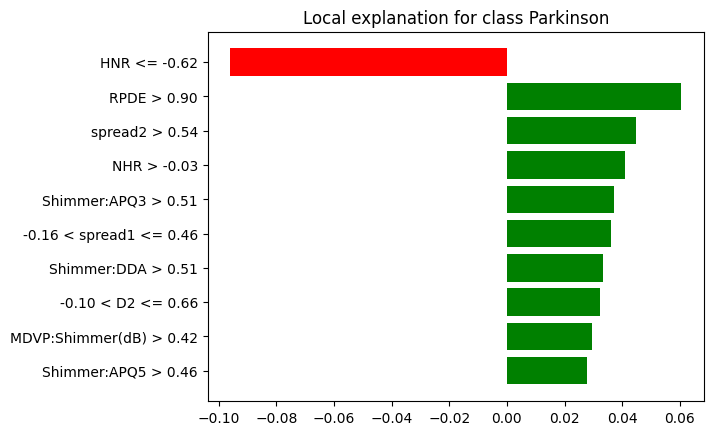


Explaining test sample #1


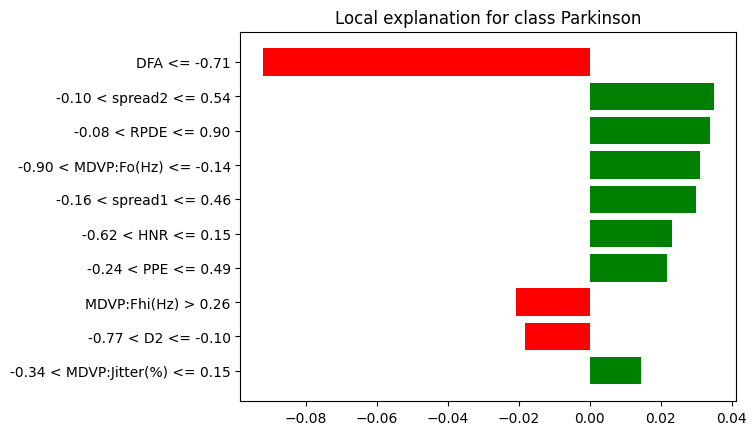


Explaining test sample #2


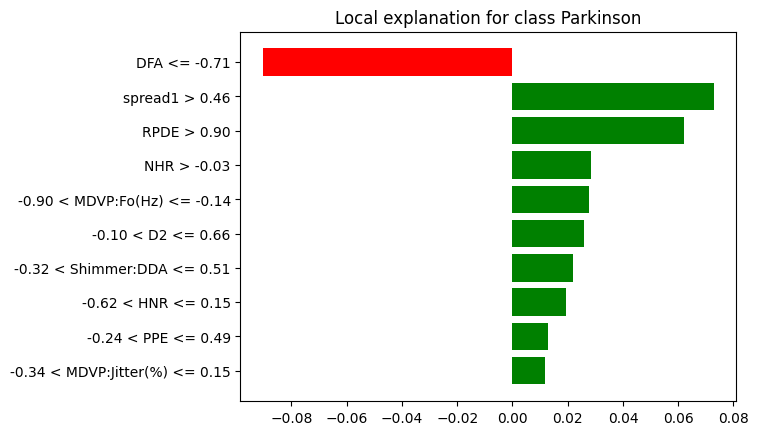

In [ ]:
for i in range(3):  # First 3 test samples
    print(f"\nExplaining test sample #{i}")
    sample = X_test[i].reshape(1, -1)
    explanation = explainer.explain_instance(
        data_row=sample[0],
        predict_fn=predict_proba_lime,
        num_features=10
    )
    explanation.show_in_notebook(show_table=True)
    explanation.as_pyplot_figure()
    plt.show()

In [ ]:
i = 0  # Index of the test sample
sample = X_test[i].reshape(1, -1)

# Model prediction
model.eval()
with torch.no_grad():
    input_tensor = torch.tensor(sample, dtype=torch.float32).unsqueeze(1)
    prob = model(input_tensor).item()
    pred_class = int(prob > 0.5)

# Actual class
true_class = int(y_test[i])

# Print info
print(f"Sample #{i}")
print(f"True Label: {'Parkinson' if true_class == 1 else 'No Parkinson'}")
print(f"Predicted Probability of Parkinson: {prob:.4f}")
print(f"Predicted Label: {'Parkinson' if pred_class == 1 else 'No Parkinson'}")

# LIME Explanation
explanation = explainer.explain_instance(
    data_row=sample[0],
    predict_fn=predict_proba_lime,
    num_features=10
)

explanation.show_in_notebook(show_table=True)

Sample #0
True Label: Parkinson
Predicted Probability of Parkinson: 0.9977
Predicted Label: Parkinson



--- Sample #0 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9977


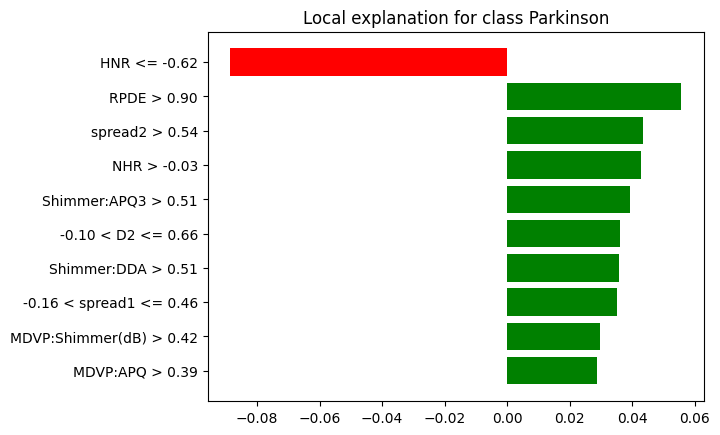


--- Sample #1 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9976


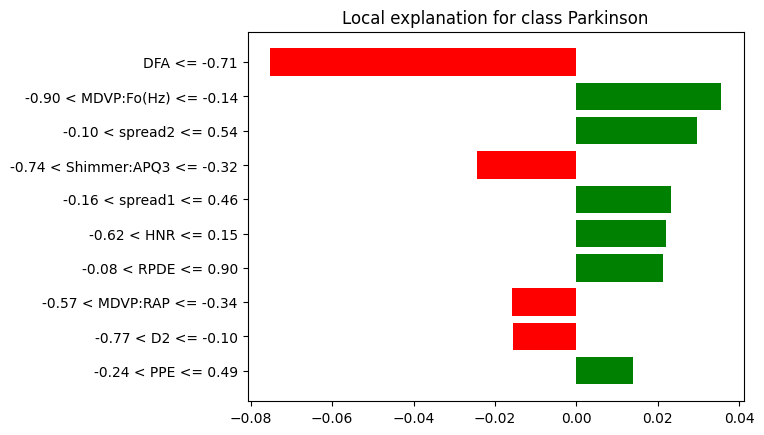


--- Sample #2 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9984


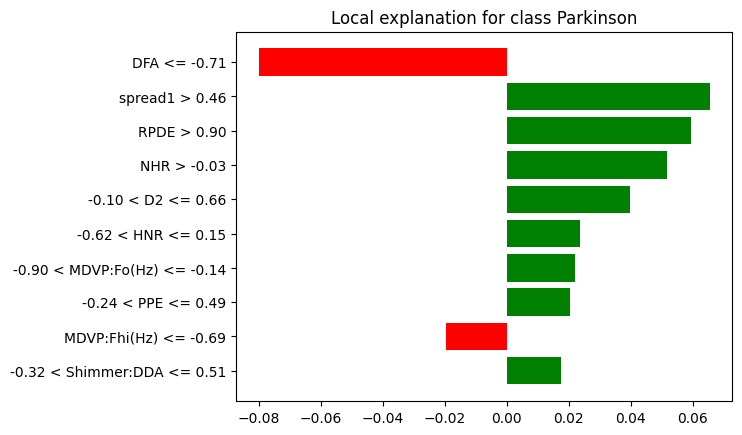


--- Sample #3 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9916


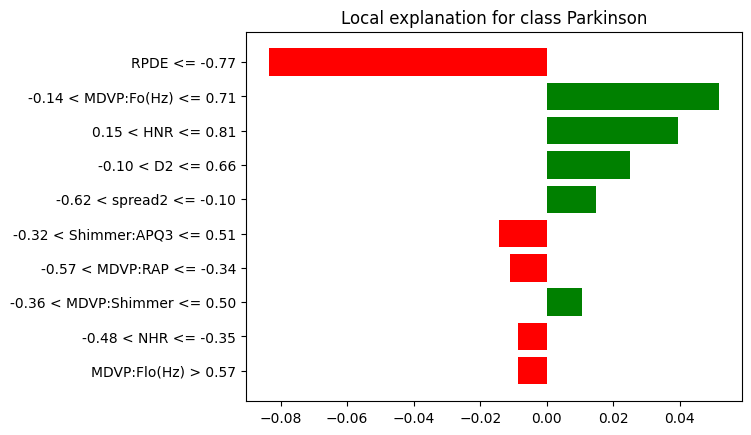


--- Sample #4 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9902


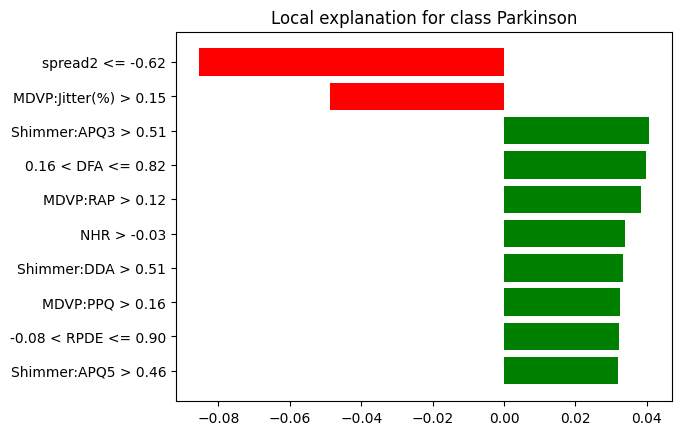


--- Sample #5 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9948

--- Sample #6 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9993

--- Sample #7 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9875

--- Sample #8 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9857

--- Sample #9 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9904

--- Sample #10 ---
True Label: No Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9787

--- Sample #11 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9994

--- Sample #12 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9966

--- Sample #13 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0

In [ ]:
max_samples = 5  # Limit number of LIME visualizations

for i in range(len(X_test)):
    sample = X_test[i].reshape(1, -1)

    # Model prediction
    model.eval()
    with torch.no_grad():
        input_tensor = torch.tensor(sample, dtype=torch.float32).unsqueeze(1)
        prob = model(input_tensor).item()
        pred_class = int(prob > 0.5)

    # Actual class
    true_class = int(y_test[i])

    # Print results
    print(f"\n--- Sample #{i} ---")
    print(f"True Label: {'Parkinson' if true_class == 1 else 'No Parkinson'}")
    print(f"Predicted Label: {'Parkinson' if pred_class == 1 else 'No Parkinson'}")
    print(f"Predicted Probability of Parkinson: {prob:.4f}")

    # Display LIME explanation (only for a few samples)
    if i < max_samples:
        explanation = explainer.explain_instance(
            data_row=sample[0],
            predict_fn=predict_proba_lime,
            num_features=10
        )
        explanation.show_in_notebook(show_table=True)
        explanation.as_pyplot_figure()
        plt.show()

Path to dataset files: /kaggle/input/parkinson-disease-detection
Epoch [1/100], Training Loss: 0.8132
Epoch [2/100], Training Loss: 0.6630
Epoch [3/100], Training Loss: 0.6184
Epoch [4/100], Training Loss: 0.5106
Epoch [5/100], Training Loss: 0.4855
Epoch [6/100], Training Loss: 0.4490
Epoch [7/100], Training Loss: 0.4225
Epoch [8/100], Training Loss: 0.4346
Epoch [9/100], Training Loss: 0.4008
Epoch [10/100], Training Loss: 0.4371
Epoch [11/100], Training Loss: 0.4066
Epoch [12/100], Training Loss: 0.3554
Epoch [13/100], Training Loss: 0.3737
Epoch [14/100], Training Loss: 0.3866
Epoch [15/100], Training Loss: 0.3782
Epoch [16/100], Training Loss: 0.3081
Epoch [17/100], Training Loss: 0.3317
Epoch [18/100], Training Loss: 0.3420
Epoch [19/100], Training Loss: 0.3308
Epoch [20/100], Training Loss: 0.3222
Epoch [21/100], Training Loss: 0.3487
Epoch [22/100], Training Loss: 0.3592
Epoch [23/100], Training Loss: 0.3665
Epoch [24/100], Training Loss: 0.3443
Epoch [25/100], Training Loss: 0

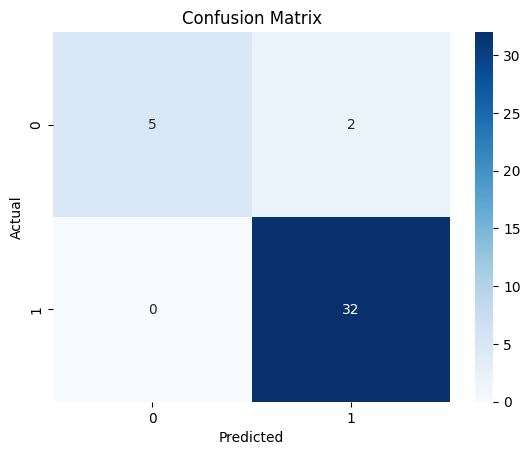

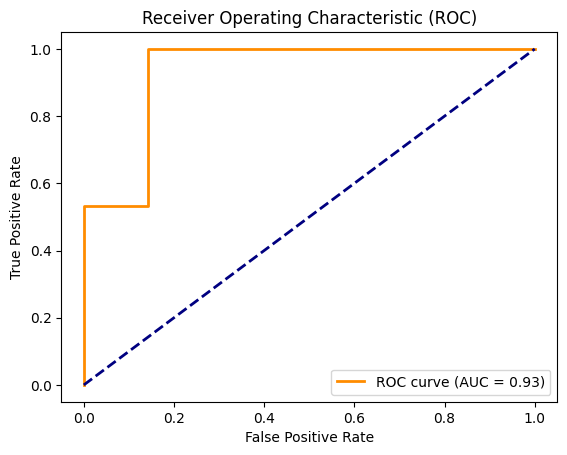


--- Sample #0 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9965


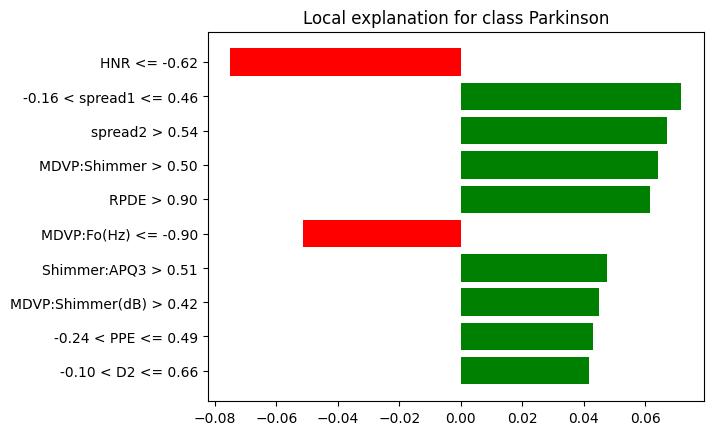


--- Sample #1 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9686


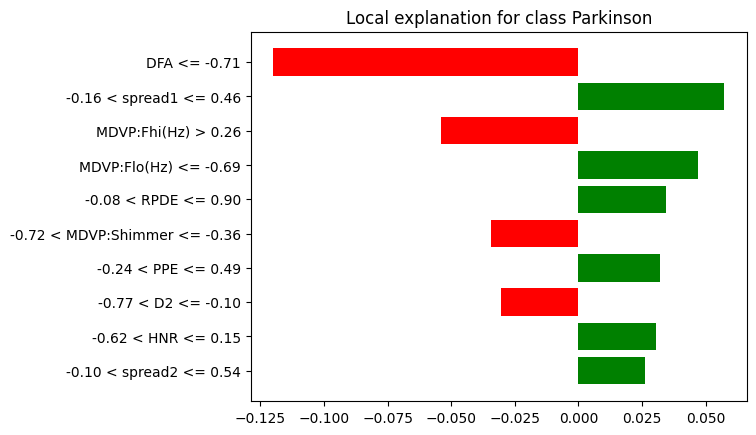


--- Sample #2 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9920


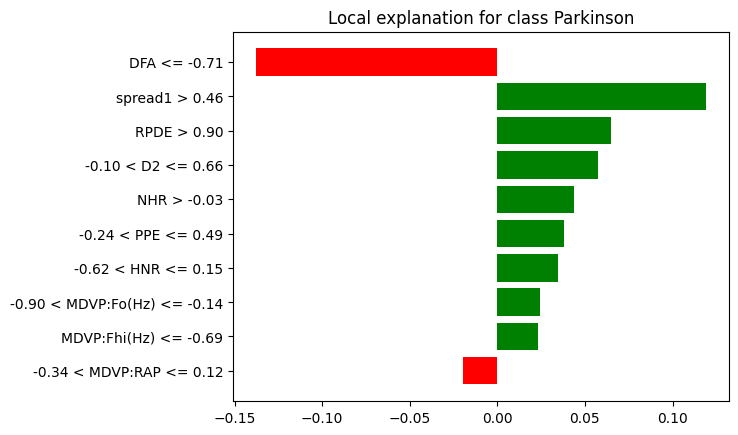


--- Sample #3 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9825


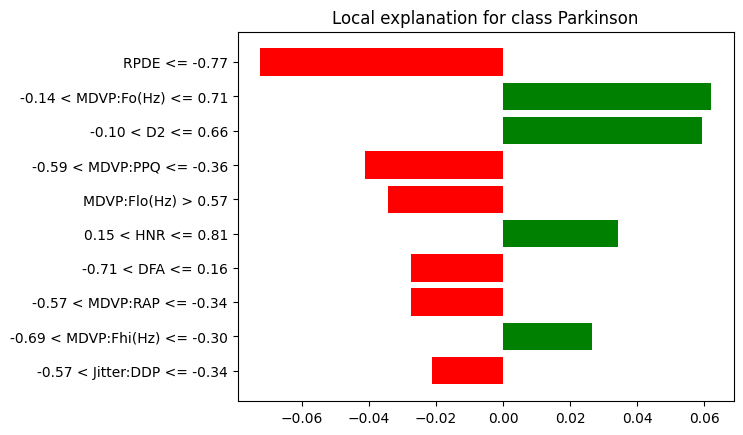


--- Sample #4 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9920


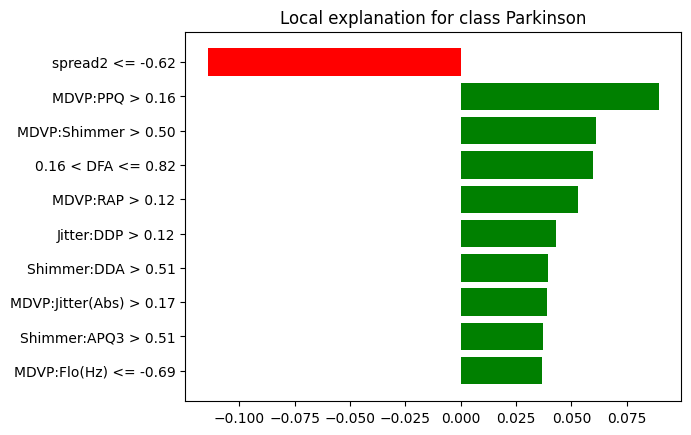

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("debasisdotcom/parkinson-disease-detection")

print("Path to dataset files:", path)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import torch
from torch import optim
from torch import nn
from torch.utils.data import DataLoader
from tqdm import tqdm

# !pip install torchvision
import torchvision

import torch.nn.functional as F
import torchvision.datasets as datasets
import torchvision.transforms as transforms

!pip install torchmetrics
import torchmetrics

import os
from torch.utils.data import Dataset, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc

# ===================== Load Dataset =====================
df = pd.read_csv('/kaggle/input/parkinson-disease-detection/Parkinsson disease.csv')
df.head()

# ===================== Feature and Target =====================
feature_cols = [
    'MDVP:Fo(Hz)', 'MDVP:Fhi(Hz)', 'MDVP:Flo(Hz)', 'MDVP:Jitter(%)',
    'MDVP:Jitter(Abs)', 'MDVP:RAP', 'MDVP:PPQ', 'Jitter:DDP',
    'MDVP:Shimmer', 'MDVP:Shimmer(dB)', 'Shimmer:APQ3', 'Shimmer:APQ5',
    'MDVP:APQ', 'Shimmer:DDA', 'NHR', 'HNR', 'RPDE', 'D2', 'DFA',
    'spread1', 'spread2', 'PPE'
]
target_col = 'status'

X = df[feature_cols].values
y = df[target_col].values

# ===================== Feature Scaling =====================
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Reshape for 1D CNN (batch_size, num_channels, sequence_length)
X_reshaped = X_scaled.reshape(X_scaled.shape[0], 1, X_scaled.shape[1])

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y, test_size=0.2, random_state=42)

# Convert to PyTorch Tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32).unsqueeze(1)

# Create DataLoaders
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
train_loader = DataLoader(train_dataset, batch_size=28, shuffle=True)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)
test_loader = DataLoader(test_dataset, batch_size=28)

# ===================== Define 1D CNN Model =====================
class Parkinson1DCNN_4Layers(nn.Module):
    def __init__(self, num_features):
        super(Parkinson1DCNN_4Layers, self).__init__()
        self.conv1 = nn.Conv1d(in_channels=1, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.bn1 = nn.BatchNorm1d(16)
        self.relu1 = nn.ReLU()
        self.pool1 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout1 = nn.Dropout(0.2)

        self.conv2 = nn.Conv1d(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm1d(32)
        self.relu2 = nn.ReLU()
        self.pool2 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout2 = nn.Dropout(0.3)

        self.conv3 = nn.Conv1d(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.bn3 = nn.BatchNorm1d(64)
        self.relu3 = nn.ReLU()
        self.pool3 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout3 = nn.Dropout(0.3)

        self.conv4 = nn.Conv1d(in_channels=64, out_channels=128, kernel_size=3, stride=1, padding=1)
        self.bn4 = nn.BatchNorm1d(128)
        self.relu4 = nn.ReLU()
        self.pool4 = nn.MaxPool1d(kernel_size=2, stride=2)
        self.dropout4 = nn.Dropout(0.3)

        flattened_size = 128 * (num_features // 16)
        self.fc1 = nn.Linear(flattened_size, 128)
        self.bn5 = nn.BatchNorm1d(128)
        self.relu5 = nn.ReLU()
        self.dropout5 = nn.Dropout(0.5)
        self.fc2 = nn.Linear(128, 1)
        self.sigmoid = nn.Sigmoid()
        self.flatten = nn.Flatten()

    def forward(self, x):
        x = self.dropout1(self.pool1(self.relu1(self.bn1(self.conv1(x)))))
        x = self.dropout2(self.pool2(self.relu2(self.bn2(self.conv2(x)))))
        x = self.dropout3(self.pool3(self.relu3(self.bn3(self.conv3(x)))))
        x = self.dropout4(self.pool4(self.relu4(self.bn4(self.conv4(x)))))
        x = self.flatten(x)
        x = self.dropout5(self.relu5(self.bn5(self.fc1(x))))
        x = self.sigmoid(self.fc2(x))
        return x

# Instantiate the model
num_features = X_scaled.shape[1]
model = Parkinson1DCNN_4Layers(num_features)

# ===================== Loss & Optimizer =====================
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# ===================== Training =====================
epochs = 100
for epoch in range(epochs):
    model.train()
    total_loss = 0
    for inputs, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item() * inputs.size(0)
    avg_loss = total_loss / len(train_loader.dataset)
    print(f'Epoch [{epoch+1}/{epochs}], Training Loss: {avg_loss:.4f}')

# ===================== Evaluation =====================
model.eval()
all_predictions = []
all_labels = []
all_probs = []
with torch.no_grad():
    for inputs, labels in test_loader:
        outputs = model(inputs)
        predicted = (outputs > 0.5).float()
        all_predictions.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_probs.extend(outputs.cpu().numpy())

accuracy = accuracy_score(all_labels, all_predictions)
report = classification_report(all_labels, all_predictions)
print(f'Accuracy on Test Set: {accuracy:.4f}')
print('Classification Report:\n', report)

# ===================== Visualizations =====================
# Confusion Matrix
cm = confusion_matrix(all_labels, all_predictions)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# ROC Curve
fpr, tpr, _ = roc_curve(all_labels, all_probs)
roc_auc = auc(fpr, tpr)
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc='lower right')
plt.show()

# Loss Curve (if tracked during training, can also plot here)
# Save and plot training loss history by adding loss_values.append(avg_loss) in training loop



--- Sample #0 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9965


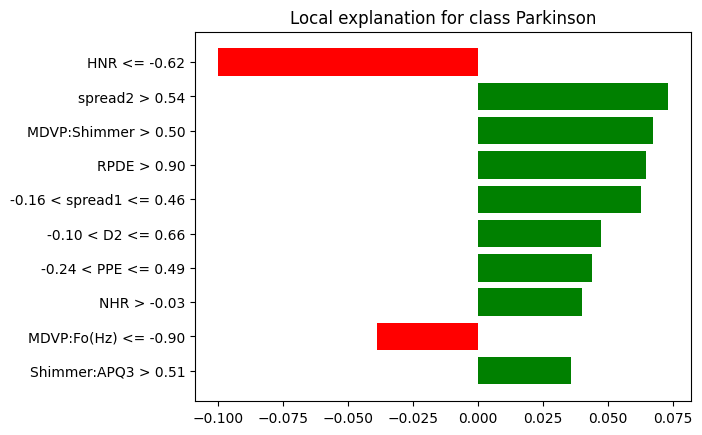


--- Sample #1 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9686


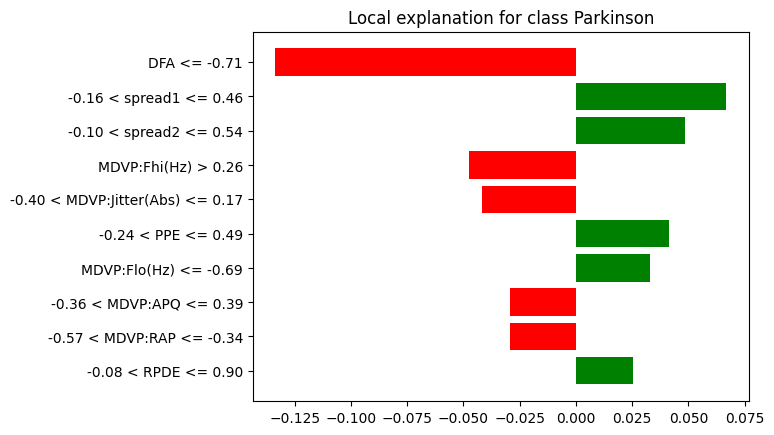


--- Sample #2 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9920


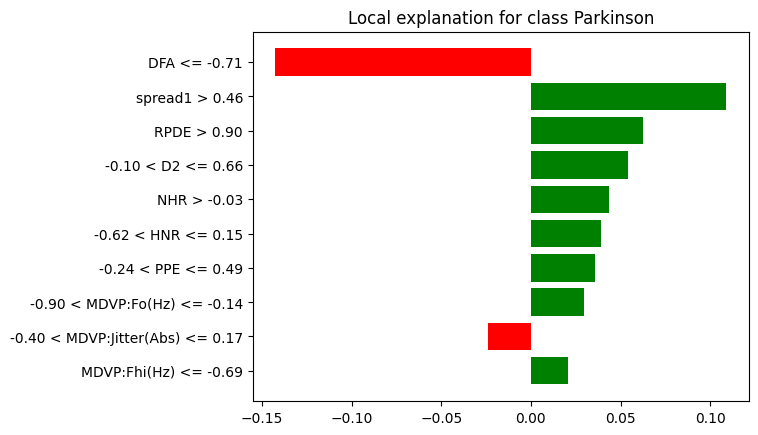


--- Sample #3 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9825


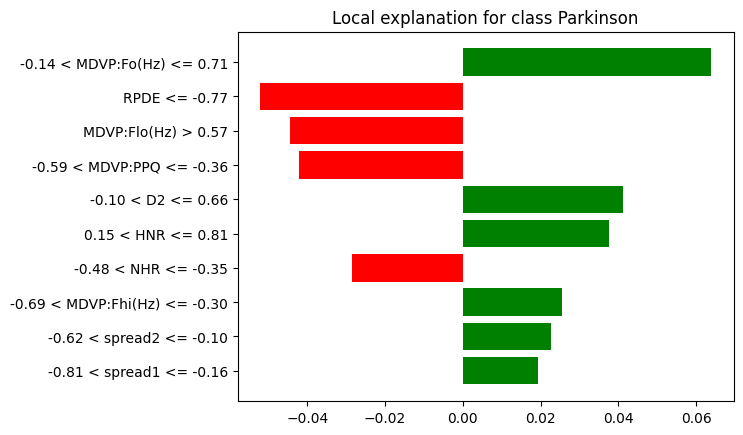


--- Sample #4 ---
True Label: Parkinson
Predicted Label: Parkinson
Predicted Probability of Parkinson: 0.9920


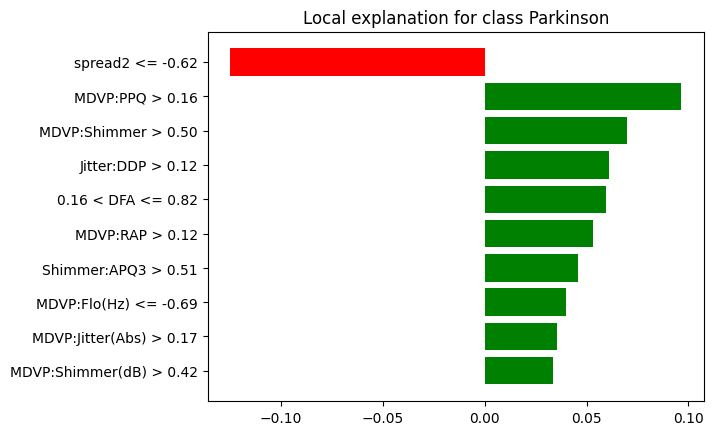

In [ ]:
!pip install lime

from lime import lime_tabular
def predict_proba_lime(input_array):
    model.eval()
    with torch.no_grad():
        input_tensor = torch.tensor(input_array, dtype=torch.float32).unsqueeze(1)  # shape: [N, 1, 22]
        output = model(input_tensor).cpu().numpy()  # shape: [N, 1]
        probs = np.concatenate([1 - output, output], axis=1)  # shape: [N, 2]
    return probs
explainer = lime_tabular.LimeTabularExplainer(
    training_data=X_train.reshape(X_train.shape[0], -1),  # Flatten to 2D
    feature_names=feature_cols,
    class_names=['No Parkinson', 'Parkinson'],
    mode='classification'
)
max_samples = 5  # You can increase this to visualize more samples

for i in range(max_samples):
    sample = X_test[i].reshape(1, -1)

    # Model prediction
    model.eval()
    with torch.no_grad():
        input_tensor = torch.tensor(sample, dtype=torch.float32).unsqueeze(1)
        prob = model(input_tensor).item()
        pred_class = int(prob > 0.5)

    # Actual class
    true_class = int(y_test[i])

    # Print results
    print(f"\n--- Sample #{i} ---")
    print(f"True Label: {'Parkinson' if true_class == 1 else 'No Parkinson'}")
    print(f"Predicted Label: {'Parkinson' if pred_class == 1 else 'No Parkinson'}")
    print(f"Predicted Probability of Parkinson: {prob:.4f}")

    # Display LIME explanation
    explanation = explainer.explain_instance(
        data_row=sample[0],
        predict_fn=predict_proba_lime,
        num_features=10
    )
    explanation.show_in_notebook(show_table=True)
    explanation.as_pyplot_figure()
    plt.show()